### 安装MMDetection及其相关依赖

In [77]:
!nvcc -V
!gcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Mon_May__3_19:15:13_PDT_2021
Cuda compilation tools, release 11.3, V11.3.109
Build cuda_11.3.r11.3/compiler.29920130_0
gcc (Ubuntu 9.4.0-1ubuntu1~20.04.1) 9.4.0
Copyright (C) 2019 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [ ]:
# !pip3 install install torch==1.10.0+cu113 torchvision==0.11.1+cu113 torchaudio==0.10.0+cu113 -f https://download.pytorch.org/whl/cu113/torch_stable.html

In [78]:
# 安装mmcv和mmengine依赖
%pip install -U "openmim==0.3.7"
!mim install "mmengine==0.7.1"
!mim install "mmcv==2.0.0rc4"

# # Install mmdetection
# !rm -rf mmdetection

# # 为了防止后续更新导致的可能无法运行，特点新建了 tutorials 分支
# !git clone -b tutorials https://github.com/open-mmlab/mmdetection.git

%cd mmdetection
!python setup.py install
%cd ..

Looking in indexes: https://mirrors.cloud.aliyuncs.com/pypi/simple
Note: you may need to restart the kernel to use updated packages.
Looking in indexes: https://mirrors.cloud.aliyuncs.com/pypi/simple
Looking in links: https://download.openmmlab.com/mmcv/dist/cu113/torch1.12.0/index.html
mim resources not found: /home/pai/lib/python3.9/site-packages/mmyolo-0.5.0-py3.9.egg/mmyolo/.mim, you can try to install the latest mmyolo.
Looking in indexes: https://mirrors.cloud.aliyuncs.com/pypi/simple
Looking in links: https://download.openmmlab.com/mmcv/dist/cu113/torch1.12.0/index.html
mim resources not found: /home/pai/lib/python3.9/site-packages/mmyolo-0.5.0-py3.9.egg/mmyolo/.mim, you can try to install the latest mmyolo.
/mnt/workspace/MMDetection Tutorial/mmdetection
running install
/home/pai/lib/python3.9/site-packages/setuptools/command/install.py:34: SetuptoolsDeprecationWarning: setup.py install is deprecated. Use build and pip and other standards-based tools.
  warnings.warn(
/home/pai

In [1]:
%matplotlib inline
%config InlineBackend.figure_format = "retina"

In [2]:
from mmengine.utils import get_git_hash
from mmengine.utils.dl_utils import collect_env as collect_base_env
import mmdet
import os
import matplotlib.pyplot as plt
from PIL import Image
import glob
import os.path as osp

import mmcv

from mmengine.fileio import dump, load
from mmengine.utils import track_iter_progress

from mmdet.registry import DATASETS, VISUALIZERS
from mmengine.config import Config
from mmengine.registry import init_default_scope

import torch
import os

In [3]:
# 环境信息收集和打印
# 方便错误排查

def collect_env():
    """Collect the information of the running environments."""
    env_info = collect_base_env()
    env_info["MMDetection"] = f"{mmdet.__version__}+{get_git_hash()[:7]}"
    return env_info


if __name__ == "__main__":
    for name, val in collect_env().items():
        print(f"{name}: {val}")

sys.platform: linux
Python: 3.9.15 (main, Nov 24 2022, 14:31:59) [GCC 11.2.0]
CUDA available: True
numpy_random_seed: 2147483648
GPU 0: NVIDIA A10
CUDA_HOME: /usr/local/cuda
NVCC: Cuda compilation tools, release 11.3, V11.3.109
GCC: gcc (Ubuntu 9.4.0-1ubuntu1~20.04.1) 9.4.0
PyTorch: 1.12.1+cu113
PyTorch compiling details: PyTorch built with:
  - GCC 9.3
  - C++ Version: 201402
  - Intel(R) Math Kernel Library Version 2020.0.0 Product Build 20191122 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v2.6.0 (Git Hash 52b5f107dd9cf10910aaa19cb47f3abf9b349815)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled (usually provided by MKL)
  - NNPACK is enabled
  - CPU capability usage: AVX2
  - CUDA Runtime 11.3
  - NVCC architecture flags: -gencode;arch=compute_37,code=sm_37;-gencode;arch=compute_50,code=sm_50;-gencode;arch=compute_60,code=sm_60;-gencode;arch=compute_70,code=sm_70;-gencode;arch=compute_75,code=sm_75;-gencode;arch=compute_80,code=sm_80;-gencode;arch=compu

### 数据集准备和可视化

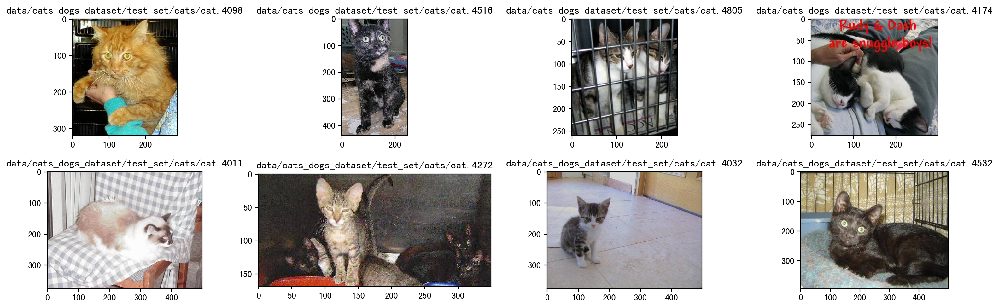

In [82]:
original_images = []
images = []
texts = []
plt.figure(figsize=(16,5))

images = glob.glob("data/cats_dogs_dataset/*/*/*.jpg")[:8]

for i, img_path in enumerate(images):
    img_name = os.path.splitext(img_path)[0]
    image = Image.open(img_path).convert('RGB')
    plt.subplot(2, 4, i+1)
    plt.imshow(image)
    plt.title(img_name)

plt.tight_layout()
plt.show()

### 将数据集格式转换成COCO

In [83]:
def convert_balloon_to_coco(ann_file, out_file, image_prefix):
    data_infos = load(ann_file)

    annotations = []
    images = []
    obj_count = 0
    for idx, v in enumerate(track_iter_progress(data_infos.values())):
        filename = v['filename']
        img_path = osp.join(image_prefix, filename)
        height, width = mmcv.imread(img_path).shape[:2]

        images.append(
            dict(id=idx, file_name=filename, height=height, width=width))

        for _, obj in v['regions'].items():
            assert not obj['region_attributes']
            obj = obj['shape_attributes']
            px = obj['all_points_x']
            py = obj['all_points_y']
            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]

            x_min, y_min, x_max, y_max = (min(px), min(py), max(px), max(py))

            data_anno = dict(
                image_id=idx,
                id=obj_count,
                category_id=0,
                bbox=[x_min, y_min, x_max - x_min, y_max - y_min],
                area=(x_max - x_min) * (y_max - y_min),
                segmentation=[poly],
                iscrowd=0)
            annotations.append(data_anno)
            obj_count += 1

    coco_format_json = dict(
        images=images,
        annotations=annotations,
        categories=[{
            'id': 0,
            'name': 'balloon'
        }])
    dump(coco_format_json, out_file)

In [84]:
convert_balloon_to_coco(ann_file='data/balloon/train/via_region_data.json',
            out_file='data/balloon/train/train_coco.json',
            image_prefix='data/balloon/train')

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 61/61, 47.4 task/s, elapsed: 1s, ETA:     0s


In [85]:
convert_balloon_to_coco(ann_file='data/balloon/val/via_region_data.json',
            out_file='data/balloon/val/val_coco.json',
            image_prefix='data/balloon/val')

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 13/13, 45.3 task/s, elapsed: 0s, ETA:     0s


### 配置文件的编写&修改

RTMDet是一个高性能低延时的检测算法，目前已经实现了**目标检测**、**实例分割**和**旋转框检测**任务。其简要描述为：为了获得更高效的模型架构，MMDetection 探索了一种具有骨干网络和Neck的架构，由一个基本的构建块构成，其中包含大核深度卷积。MMDetection进一步在动态标签分配中计算匹配成本时引入软标签，以提高准确性，结合更好的训练技巧，得到的目标检测器名为RTMDet，在NVIDIA 3090 GPU上以超过300 FPS的速度实现了52.8%的COCO AP，优于当前流的工业检测器RTMDet在小/中/大特大型模型尺寸中实现了最佳的参数-准确度权衡，适用于各种应用场景，并在实时实例分割和旋转对象检测方面取得了新的最先进性能。

In [ ]:
config_cat = """
# 把一些常用的配置参数放在前面，下面去引用这些常量即可，修改会比较方便
_base_='/content/mmdetection/configs/rtmdet/rtmdet-ins_tiny_8xb32-300e_coco.py'

train_batch_size_per_gpu=32
train_num_workers=2

val_batch_size_per_gpu=4
val_num_workers=2

num_classes=1

# 由于数据集小，同时训练epoch次数少，可以把backbone固定，RTMDet的backbone就4个stage，所以下面frozen_stage=4就是全部固定（不是从0开始，就是1 2 3 4），可以看看上面的图或者论文
# 只让模型去学head部分，做下游任务的适配即可
model =dict(
  backbone = dict(frozen_stages=4),
  bbox_head=dict(dict(num_classes=num_classes))
)

# 学习率随着batchsize改变,0.04是8卡x32（每个卡的batchsize=32）的学习率,
# 12是这里设置的train_batch_size_per_gpu，
# 所以学习率要根据卡数和batchsize数（也就是计算梯度loss时实际使用的数据量）
# 0.04/(32*8)就是纯纯训练一个数据的学习率
base_lr = train_batch_size_per_gpu*0.04/(32*8)

# RTMDet训练过程分为两个Stage，第二个过程会切换数据增强pipeline，第二阶段的epoch次数是5
# max_epochs=40，也就是前35个是一套数据增强，最后5个是一套数据增强，两阶段
max_epochs=40
num_epochs_stage2=5

# 这个预训练模型组织方式和mmpretrain不一样，需要在github对应网络的readme里找，
# https://github.com/open-mmlab/mmdetection/tree/main/configs/rtmdet
# finetune 用之前训练好的预训练权重
load_from = 'https://download.openmmlab.com/mmdetection/v3.0/rtmdet/rtmdet-ins_tiny_8xb32-300e_coco/rtmdet-ins_tiny_8xb32-300e_coco_20221130_151727-ec670f7e.pth'

# 数据集改变了，则train_loader那些也要变
data_root = '/content/cat_dataset'

# metainfo这个字段在mmdetection2.0没有，3.0里才有，而且只包含两个字段，
# classes就是类别，palette就是对这个类进行可视化的时候用的颜色，也是为了方便调节吧，所以抽出来了
# 注意：classes是一个tuple，所以即使只有一个类，也应该写成`cat,`
metainfo={
  'classes':('cat',),
  'palette':[(220,20,60),]
}

train_dataloader = dict(
    batch_size=train_batch_size_per_gpu,
    num_workers=train_num_workers,
    pin_memory=True,
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        data_prefix=dict(img='images/'),
        ann_file='annotations/trainval.json'
    )
)

val_dataloader = dict(
    batch_size=val_batch_size_per_gpu,
    num_workers=val_num_workers,
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        data_prefix=dict(img='images/'),
        ann_file='annotations/test.json'
   )
)

test_dataloader = val_dataloader

# 默认的学习率调度器是warmup 1000，但是cat数据集太小了，需要修改为30 iter
param_scheduler = [
    dict(
        type='LinearLR',
        start_factor=1.0e-5,
        by_epoch=False,
        begin=0,
        end=30),
    dict(
        # use cosine lr from 10 to 20 epoch
        type='CosineAnnealingLR',
        eta_min=base_lr * 0.05,
        begin=max_epochs // 2,  #max_epoch也需要改变
        end=max_epochs,
        T_max=max_epochs // 2,
        by_epoch=True,
        convert_to_iter_based=True),
]
optim_wrapper = dict(optimizer=dict(lr=base_lr))

# 第二stage切换pipeline的epoch也变了
_base_.custom_hooks[1].switch_epoch = max_epochs-num_epochs_stage2

val_evaluator = dict(ann_file=data_root + '/annotations/test.json')
test_evaluator=val_evaluator

# 打印设置
default_hooks = dict(
    checkpoint=dict(interval=10,max_keep_ckpts=2, save_best='auto'),
    logger=dict(type='LoggerHook', interval=5))
train_cfg= dict(max_epochs=max_epochs, val_interval=10)

"""

需要注意的问题:
- 自定义数据集中最重要的是metainfo字段，用户在配置完成后要记得将其传给dataset，否则不生效
- 如果用户metainfo配置不正确，通常会出现几种情况：（1）出现num_classes不匹配错误 （2）loss_bbox始终为0 （3）出现训练后评估结果为空等典型情况
- MMDetection提供的学习率大部分都是基于8卡，若训练bs不同，则记得缩放学习率

### 训练前可视化验证

通过mmdet提供的browse_dataset.py脚本，来对训练前的dataloader输出进行可视化，实现一个简单版本的browse_dataset.py脚本

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


/home/pai/lib/python3.9/site-packages/mmengine/utils/manager.py:113: UserWarning: <class 'mmdet.visualization.local_visualizer.DetLocalVisualizer'> instance named of visualizer has been created, the method `get_instance` should not accept any other arguments
  warnings.warn(
/home/pai/lib/python3.9/site-packages/mmdet-3.0.0-py3.9.egg/mmdet/visualization/palette.py:90: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  scales = 0.5 + (areas - min_area) // (max_area - min_area)
/home/pai/lib/python3.9/site-packages/mmengine/visualization/visualizer.py:741: UserWarning: Warning: The bbox is out of bounds, the drawn bbox may not be in the image
  warnings.warn(
/home/p

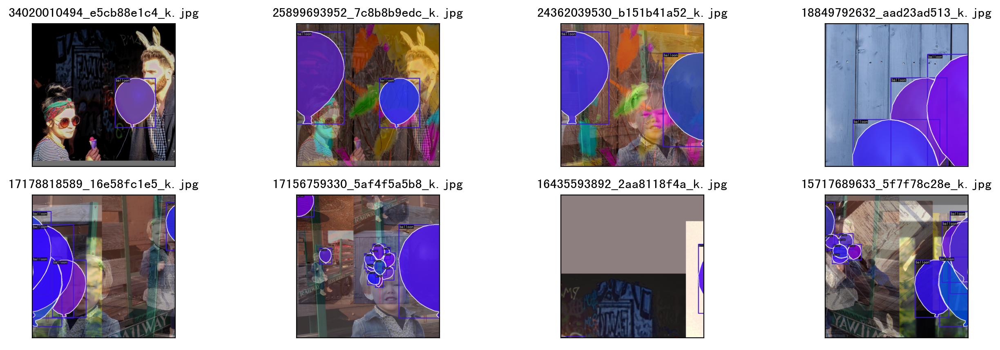

In [86]:
cfg = Config.fromfile('custom_config_rtmdet.py')

init_default_scope(cfg.get('default_scope', 'mmdet'))

dataset = DATASETS.build(cfg.train_dataloader.dataset)
visualizer = VISUALIZERS.build(cfg.visualizer)
visualizer.dataset_meta = dataset.metainfo

plt.figure(figsize=(16, 5))
# 只可视化前 8 张图片
for i in range(8):
    item = dataset[i]
    img = item['inputs'].permute(1, 2, 0).numpy()
    data_sample = item['data_samples'].numpy()
    gt_instances = data_sample.gt_instances
    img_path = osp.basename(item["data_samples"].img_path)

    gt_bboxes = gt_instances.get("bboxes", None)
    gt_instances.bboxes = gt_bboxes.tensor

    visualizer.add_datasample(
        osp.basename(img_path),
        img,
        data_sample,
        draw_pred=False,
        show=False)
    drawed_image=visualizer.get_image()

    plt.subplot(2, 4, i+1)
    plt.imshow(drawed_image[..., [2, 1, 0]])
    plt.title(f"{osp.basename(img_path)}")
    plt.xticks([])
    plt.yticks([])

### 模型训练

In [4]:
import torch
torch.cuda.empty_cache()

import os
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "max_split_size_mb:512"

In [ ]:
!python mmdetection/tools/train.py \
'custom_config_rtmdet.py' \
--work-dir 'exps/rtmdet'

### 模型测试和推理

若想要进行离线测试，则可以使用提供的test.py脚本

In [ ]:
!python mmdetection/tools/test.py \
'custom_config_rtmdet.py' \
'exps/rtmdet/best_coco/bbox_mAP_epoch_30.pth' \
--work-dir "exps/rtmdet" \
--show-dir "result"

### 可视化预测效果

- 左边是Groundtruth，右边是相应的预测结果

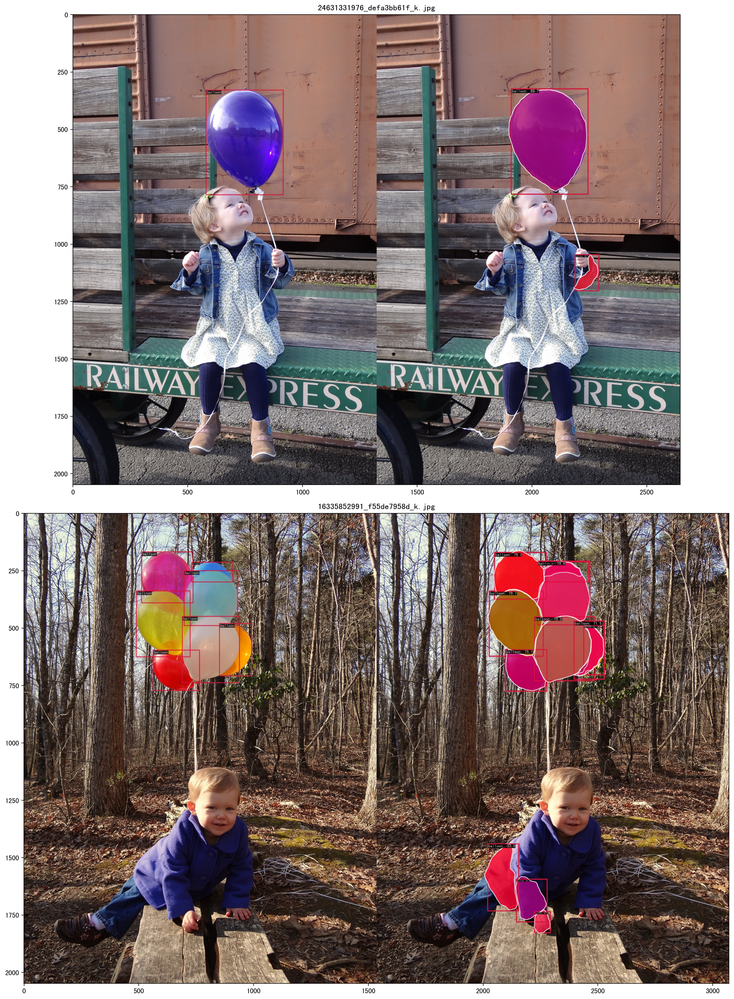

In [5]:
plt.figure(figsize=(20,20))

output_path = 'exps/rtmdet/20230618_164640/result'
imgs = os.listdir(output_path)[:2]

for i, img_name in enumerate(imgs):
    img = Image.open(os.path.join(output_path, img_name)).convert("RGB")
    plt.subplot(2, 1, i+1)
    plt.imshow(img)
    plt.title(img_name)
plt.tight_layout()

### 单张图片推理

In [ ]:
!python mmdetection/demo/image_demo.py pics/1.jpg \
"custom_config_rtmdet.py" --weight "exps/rtmdet/best_coco/bbox_mAP_epoch_30.pth" \
--out-dir "output"

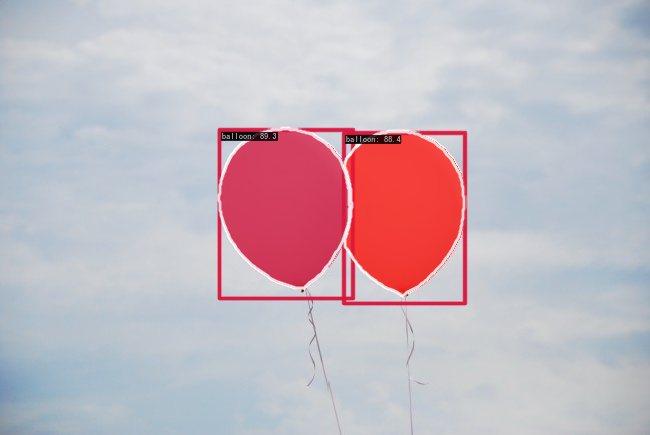

In [2]:
Image.open('output/vis/1.jpg')

In [ ]:
!python mmdetection/demo/image_demo.py pics/2.jpg \
"custom_config_rtmdet.py" --weight "exps/rtmdet/best_coco/bbox_mAP_epoch_30.pth" \
--out-dir "output"

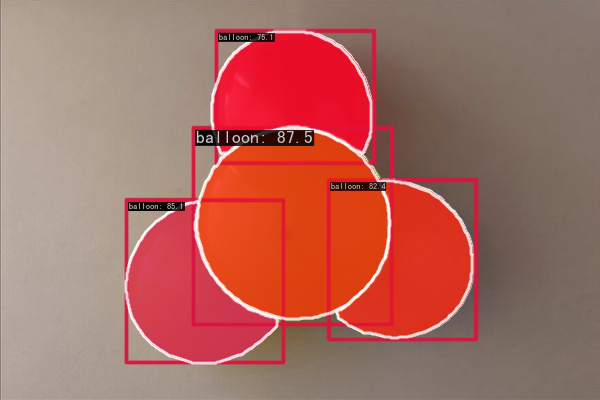

In [3]:
Image.open('output/vis/2.jpg')

### 特征图可视化

- 安装MMYOLO，使用其中脚本进行特征图可视化

In [ ]:
# !rm -rf mmyolo
# !git clone https://github.com/open-mmlab/mmyolo.git
%cd mmyolo
!python setup.py install
%cd ..

In [ ]:
import cv2
img_path = "mmdetection/demo/demo.jpg"
img = cv2.imread(img_path)
h, w = img.shape[:2]

resized_img = cv2.resize(img, (640, 640))
cv2.imwrite('pics/resized_img.jpg', resized_img)

#### 可视化backbone的三个通道

In [ ]:
!python mmyolo/demo/featmap_vis_demo.py pics/resized_img.jpg \
custom_config_rtmdet.py \
exps/rtmdet/best_coco/bbox_mAP_epoch_30.pth \
--target-layers backbone\
--channel-reduction squeeze_mean

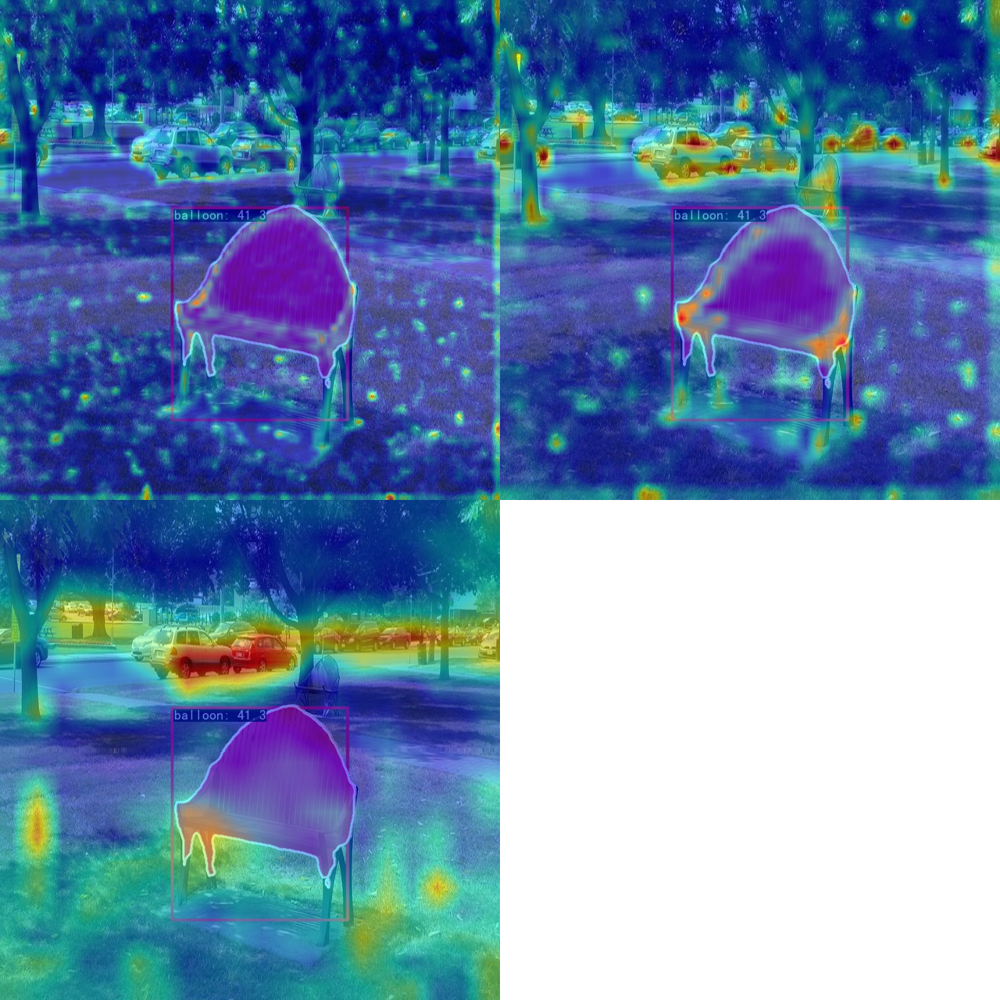

In [4]:
Image.open('output/resized_img.jpg')

#### 可视化backbone的三个通道

In [ ]:
!python mmyolo/demo/featmap_vis_demo.py pics/resized_img.jpg \
custom_config_rtmdet.py \
exps/rtmdet/best_coco/bbox_mAP_epoch_30.pth \
--target-layers neck \
--channel-reduction squeeze_mean

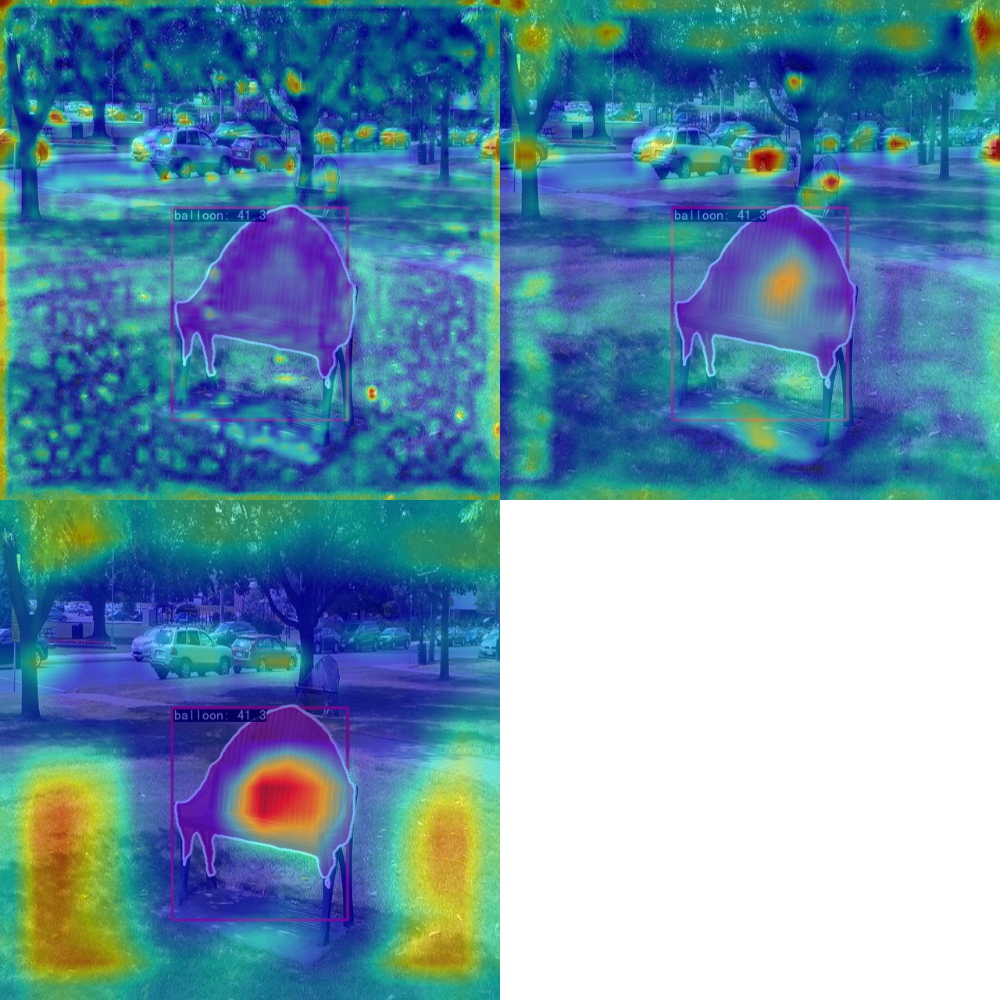

In [6]:
Image.open('output/resized_img.jpg')

### Grad-Based CAM可视化

由于目标检测的特殊性，实际上使用Grad Box AM进行可视化。

In [ ]:
!pip install "grad-cam"==1.4.6

- neck输出的最小特征图的Grad CAM

In [ ]:
# 出现bug 暂时无法解决
!python mmyolo/demo/boxam_vis_demo.py pics/resized_img.jpg \
custom_config_rtmdet.py \
exps/rtmdet/best_coco/bbox_mAP_epoch_30.pth \
--target-layers neck.out_convs[2]

In [ ]:
Image.open('output/resized_img.jpg')

### 目标检测新趋势

随着大语言模型的飞速发展，目标检测逐渐从传统的封闭集合检测向和自然语言结合的开放类别检测发展，典型的方向如下：
1.Open-Vocabulary Object Detection：开放词汇目标检测，给定图片和类别词汇表，检测所有物体
2.Grounding Object Detection：给定图片和文本描述，预测文本中所提到的在图片中的物体位置 

该方向的典型算法是GLIP，目前在MMDetection的dev-3.x中已经支持